In [14]:
from DataProcessor import Data_Processor
from DataProcessor import clean
import numpy as np
from fuzzywuzzy import fuzz
from fuzzywuzzy import process

import os
import pandas as pd
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import os
import re
import plotly.tools as tls
import plotly.figure_factory as ff
import plotly as py
import plotly.graph_objs as go
import gensim
from gensim import corpora, models, similarities
import logging
import tempfile
import nltk
nltk.download('stopwords')
from string import punctuation
from collections import OrderedDict
import seaborn as sns
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import json

init_notebook_mode(connected=True) #do not miss this line
import warnings
warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/yunzehui/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
//anaconda3/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



# Wells Fargo

In [2]:
DP=Data_Processor(start_month='2017-06',end_month='2020-05',template="Wells Fargo/WellsFargo")
DP.readdata()
print(DP.datanums())
DP.specifylang()
DP.removenoise() #NEW 
DP.clean()

([10217, 10260, 10257, 9991, 10206, 10213, 10223, 10215, 10203, 10156, 10111, 9648, 9918, 10217, 10221, 10168, 10214, 10170, 9951, 10164, 10208, 10185, 10143, 10197, 10049, 10171, 10082, 10000, 10217, 10199, 9541, 10128, 10220, 10184, 10145, 10144], 364536)


In [3]:
#DP.Data
DP.data[0]#get the first month data

[{'has_media': False,
  'hashtags': [],
  'img_urls': [],
  'is_replied': False,
  'is_reply_to': True,
  'likes': 0,
  'links': [],
  'parent_tweet_id': '875129621288689664',
  'replies': 0,
  'reply_to_users': [{'screen_name': 'Ask_WellsFargo', 'user_id': '23002858'}],
  'retweets': 0,
  'screen_name': 'jimgoodman',
  'text': 'It all started because the local branch manager who I stopped to see twice was never in and didnt contact me like they said she would',
  'text_html': '<p class="TweetTextSize js-tweet-text tweet-text" data-aria-label-part="0" lang="en">It all started because the local branch manager, who I stopped to see twice was never in and didn\'t contact me like they said s/he would....</p>',
  'timestamp': '2017-06-14T23:59:13',
  'timestamp_epochs': 1497484753,
  'tweet_id': '875140600667951104',
  'tweet_url': '/jimgoodman/status/875140600667951104',
  'user_id': '14126874',
  'username': 'Jim Goodman',
  'video_url': ''},
 {'has_media': False,
  'hashtags': [],
  'img

In [4]:
bigrams=DP.getngrams(num=2,lemma=True)
DP.getfreq(bigrams)

[('wellfargo', 101225),
 ('fargocenter', 7138),
 ('fargobank', 3161),
 ('fargoarena', 2491),
 ('presentedwellsfargo', 2357),
 ('bankamerica', 2260),
 ('customerservice', 1958),
 ('mlsworkspresented', 1889),
 ('creditcard', 1759),
 ('creditunion', 1513),
 ('bankwell', 1380),
 ('likewell', 1366),
 ('debitcard', 1235),
 ('fargoinvestment', 1200),
 ('investmentinstitute', 1187),
 ('fargoaccount', 1172),
 ('bankaccount', 1171),
 ('imwell', 1169),
 ('smallbusiness', 1161),
 ('fakeaccount', 1124),
 ('fargoceo', 1098),
 ('thankwellsfargo', 1004),
 ('bigbank', 886),
 ('teammember', 876),
 ('yearago', 837),
 ('hatewell', 795),
 ('fuckwell', 777),
 ('banklike', 764),
 ('dontknow', 755),
 ('overdraftfee', 745),
 ('looklike', 718),
 ('worstbank', 713),
 ('jpmorganchase', 713),
 ('joinu', 661),
 ('ubank', 647),
 ('chasewell', 645),
 ('lastyear', 625),
 ('thankswellsfargo', 616),
 ('jpmorgan', 614),
 ('wellsfargoteam', 599),
 ('accountwell', 596),
 ('fargobranch', 595),
 ('cantwait', 582),
 ('demoine

In [5]:
unigrams=DP.getngrams(num=1,lemma=True)
DP.getfreq(unigrams)

[('well', 106288),
 ('fargo', 102151),
 ('wellsfargo', 46162),
 ('bank', 29772),
 ('account', 15519),
 ('get', 12819),
 ('im', 12412),
 ('u', 12400),
 ('like', 12043),
 ('money', 10146),
 ('customer', 9421),
 ('dont', 9246),
 ('time', 9041),
 ('center', 8580),
 ('year', 8425),
 ('people', 7705),
 ('day', 7427),
 ('need', 7376),
 ('card', 7319),
 ('know', 7078),
 ('go', 7055),
 ('business', 6973),
 ('thank', 6697),
 ('new', 6506),
 ('got', 6422),
 ('help', 6341),
 ('would', 6294),
 ('back', 6037),
 ('home', 5601),
 ('still', 5520),
 ('see', 5443),
 ('credit', 5296),
 ('thanks', 5198),
 ('work', 5004),
 ('check', 4968),
 ('good', 4932),
 ('company', 4928),
 ('cant', 4887),
 ('say', 4866),
 ('service', 4842),
 ('take', 4823),
 ('loan', 4673),
 ('want', 4664),
 ('going', 4620),
 ('right', 4576),
 ('pay', 4495),
 ('chase', 4491),
 ('million', 4305),
 ('even', 4300),
 ('call', 4203),
 ('mortgage', 4135),
 ('great', 4098),
 ('never', 4067),
 ('way', 4045),
 ('please', 4030),
 ('fee', 3996),
 

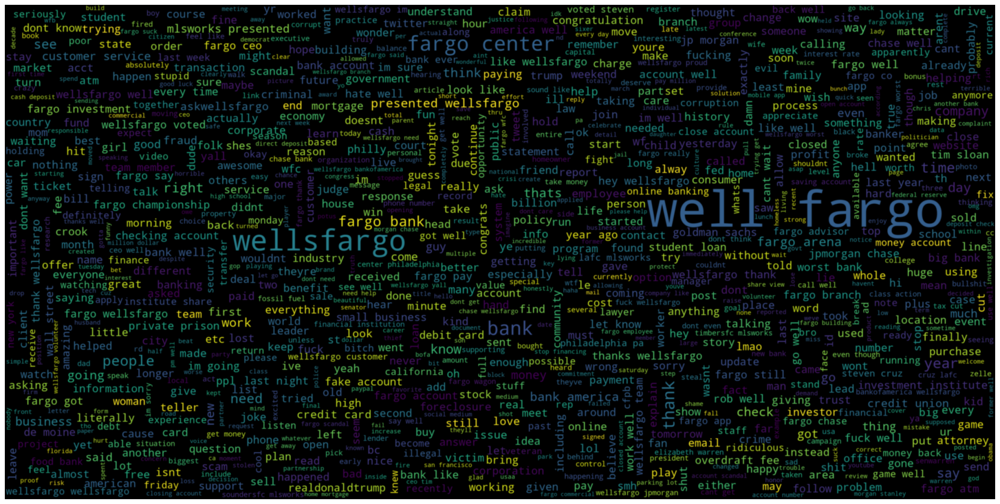

In [6]:
DP.wordcld(unigrams) #input must be unigrams

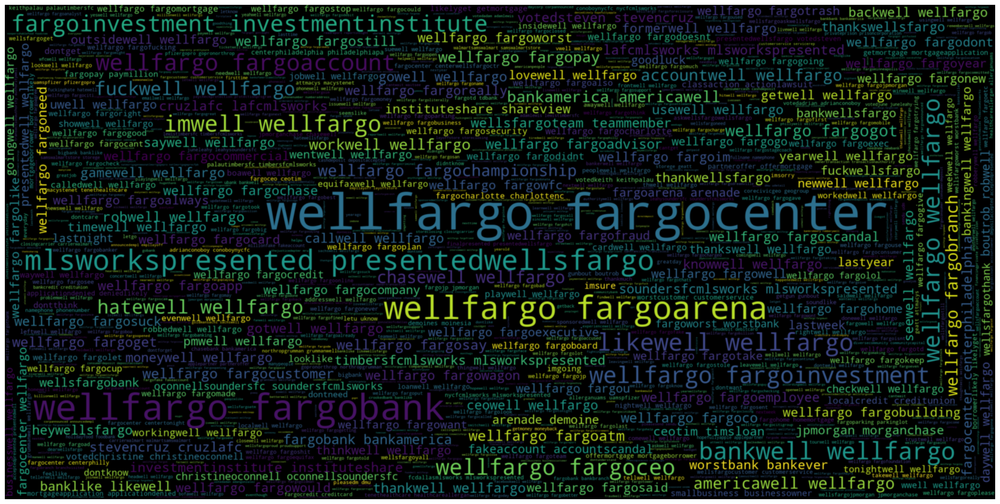

In [7]:
DP.wordcld(bigrams) #input must be unigrams

In [32]:
col=['tweet_id','tweet_url','text','text_html','links','hashtags', 'img_urls','timestamp','timestamp_epochs','likes','replies','retweets','username','screen_name','user_id','is_reply_to','is_replied','reply_to_users','parent_tweet_id','has_media']
DF = pd.DataFrame(columns=col)
for i in range(len(DP.data)):
    tweets = pd.DataFrame(DP.data[i])
    DF = DF.append(tweets[col])
print("Number of tweets: ",len(DF['text']))
DF.head(5)

Number of tweets:  197610


,tweet_id,tweet_url,text,text_html,links,hashtags,img_urls,timestamp,timestamp_epochs,likes,replies,retweets,username,screen_name,user_id,is_reply_to,is_replied,reply_to_users,parent_tweet_id,has_media
0,875140600667951104,/jimgoodman/status/875140600667951104,It all started because the local branch manage...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[],[],[],2017-06-14T23:59:13,1497484753,0,0,0,Jim Goodman,jimgoodman,14126874,True,False,"[{'screen_name': 'Ask_WellsFargo', 'user_id': ...",875129621288689664,False
1,875140113147219968,/Adam_Zimmerman/status/875140113147219968,Yes WellsFargo moved to compel arbitration for...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[],[],[],2017-06-14T23:57:16,1497484636,1,1,0,Adam Zimmerman,Adam_Zimmerman,276024235,True,True,"[{'screen_name': 'Andrew___Baker', 'user_id': ...",875133565356224512,False
2,875139808691138562,/AnthonyMingioni/status/875139808691138562,He prefers the Wells Fargo Center Cookies and ...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[],[],[],2017-06-14T23:56:04,1497484564,1,0,0,Anthony Mingioni,AnthonyMingioni,60237024,True,False,"[{'screen_name': 'Jeff_Neiburg', 'user_id': '1...",875138396640989185,False
3,875138836032049152,/JForsett/status/875138836032049152,SO to WellsFargo and brianbuffini Success tour...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[],[],[https://pbs.twimg.com/media/DCUeINbXYAUqkEA.jpg],2017-06-14T23:52:12,1497484332,5,0,2,Justin Forsett,JForsett,58668876,False,False,[],,True
4,875138006583267328,/pressmansteven/status/875138006583267328,Bush Ed Dept as bad as Wells Fargo,"<p class=""TweetTextSize js-tweet-text tweet-te...",[],[],[],2017-06-14T23:48:54,1497484134,1,0,0,Steven Pressman,pressmansteven,1031709230,True,False,"[{'screen_name': 'DugganMarieC', 'user_id': '8...",875109826715672578,False


In [43]:
DF['timestamp'] = pd.to_datetime(DF['timestamp'])
tweetsT = DF['timestamp']

trace = go.Histogram(
    x=tweetsT,
    marker=dict(
        color='blue'
    ),
    opacity=0.75
)

layout = go.Layout(
    title='Tweet Activity Over Years',
    height=450,
    width=1200,
    xaxis=dict(
        title='Month and year'
    ),
    yaxis=dict(
        title='Tweet Quantity'
    ),
    bargap=0.2,
)

data = [trace]

fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig)

Text(0.5, 1.0, 'popular username')

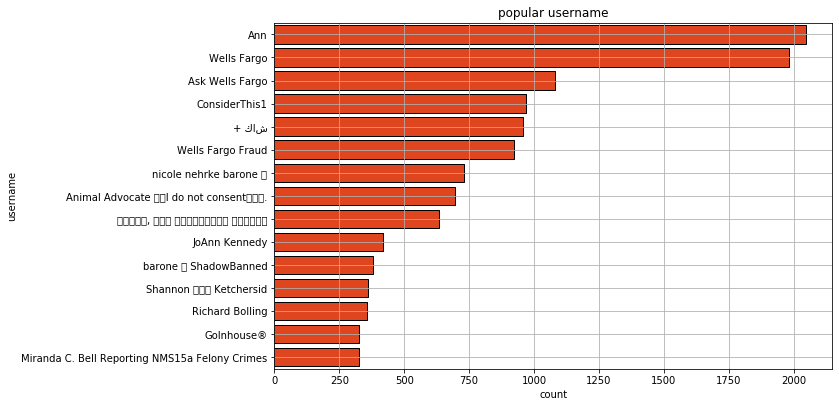

In [46]:
plt.figure(figsize = (10,14))

plt.subplot(211)
authors = DF["username"].value_counts().reset_index()
sns.barplot(y = authors["index"][:15] , 
            x = authors["username"][:15] ,
            linewidth = 1,edgecolor = "k",color = "#FF3300")
plt.grid(True)
plt.xlabel("count")
plt.ylabel("username")
plt.title("popular username")

## Grading by positive/negative_words list

In [48]:
#positive words
positive_words = pd.read_csv(r"positive-words.txt",header=None, error_bad_lines=False)
#negative words
negative_words = pd.read_csv(r"negative-words.txt",
                             header=None,encoding='latin-1',error_bad_lines=False)

from nltk.corpus import stopwords
stop_words = stopwords.words("english")
def string_manipulation(df,column)  : 
    #extract hashtags
    df["hashtag"]  = df[column].str.findall(r'#.*?(?=\s|$)')
    #extract twitter account references
    df["accounts"] = df[column].str.findall(r'@.*?(?=\s|$)')
    
    #remove hashtags and accounts from tweets
    df[column] = df[column].str.replace(r'@.*?(?=\s|$)'," ")
    df[column] = df[column].str.replace(r'#.*?(?=\s|$)'," ")
    
    #convert to lower case
    df[column] = df[column].str.lower()
    #remove hyperlinks
    df[column] = df[column].apply(lambda x:re.split('https:\/\/.*',str(x))[0])
    #remove punctuations
    df[column] = df[column].str.replace('[^\w\s]'," ")
    #remove special characters
    df[column] = df[column].str.replace("\W"," ")
    #remove digits
    df[column] = df[column].str.replace("\d+"," ")
    #remove under scores
    df[column] = df[column].str.replace("_"," ")
    #remove stopwords
    df[column] = df[column].apply(lambda x: " ".join([i for i in x.split() 
                                                      if i not in (stop_words)]))
    return df

#convert words to lists
def convert_words_list(df) : 
    words = string_manipulation(df,0)
    words_list = words[words[0] != ""][0].tolist()
    return words_list

positive_words_list = convert_words_list(positive_words)

#remove word trump from positive word list
positive_words_list = [i for i in positive_words_list if i not in "trump"]
negative_words_list = convert_words_list(negative_words)

print ( "positive words : " )
print (positive_words_list[:50])
print ( "negative words : " )
print (negative_words_list[:50])

positive words : 
['opinion lexicon positive', 'file contains list positive opinion words sentiment words', 'file papers downloaded', 'http www cs uic edu liub fbs sentiment analysis html', 'minqing hu bing liu mining summarizing customer reviews', 'proceedings acm sigkdd international conference knowledge', 'comparing opinions web proceedings th', 'notes', 'appearance opinion word sentence necessarily', 'mean sentence expresses positive negative opinion', 'see paper', 'bing liu sentiment analysis subjectivity chapter', 'notice many misspelled words list', 'mistakes included misspelled words appear', 'frequently social media content', 'abound', 'abounds', 'abundance', 'abundant', 'accessable', 'accessible', 'acclaim', 'acclaimed', 'acclamation', 'accolade', 'accolades', 'accommodative', 'accomodative', 'accomplish', 'accomplished', 'accomplishment', 'accomplishments', 'accurate', 'accurately', 'achievable', 'achievement', 'achievements', 'achievible', 'acumen', 'adaptable', 'adaptive',

b'Skipping line 10: expected 1 fields, saw 2\nSkipping line 14: expected 1 fields, saw 5\nSkipping line 15: expected 1 fields, saw 3\nSkipping line 16: expected 1 fields, saw 2\nSkipping line 18: expected 1 fields, saw 3\nSkipping line 19: expected 1 fields, saw 3\nSkipping line 27: expected 1 fields, saw 3\nSkipping line 28: expected 1 fields, saw 2\n'
b'Skipping line 10: expected 1 fields, saw 2\nSkipping line 14: expected 1 fields, saw 5\nSkipping line 15: expected 1 fields, saw 3\nSkipping line 16: expected 1 fields, saw 2\nSkipping line 18: expected 1 fields, saw 3\nSkipping line 19: expected 1 fields, saw 3\nSkipping line 27: expected 1 fields, saw 3\nSkipping line 28: expected 1 fields, saw 2\n'


In [49]:
# function to score tweets based on positive and negative words present
def scoring_tweets(data_frame,text_column) :
    #identifying +ve and -ve words in tweets
    data_frame["positive"] = data_frame[text_column].apply(lambda x:" ".join([i for i in x.split() 
                                                                              if i in (positive_words_list)]))
    data_frame["negative"] = data_frame[text_column].apply(lambda x:" ".join([i for i in x.split()
                                                                              if i in (negative_words_list)]))
    #scoring
    data_frame["positive_count"] = data_frame["positive"].str.split().str.len()
    data_frame["negative_count"] = data_frame["negative"].str.split().str.len()
    data_frame["score"]          = (data_frame["positive_count"] -
                                    data_frame["negative_count"])
    
    #create new feature sentiment :
    #+ve if score is +ve , #-ve if score is -ve , # neutral if score is 0
    def labeling(data_frame) :
        if data_frame["score"]   > 0  :
            return "positive"
        elif data_frame["score"] < 0  :
            return "negative"
        elif data_frame["score"] == 0 :
            return "neutral"
    data_frame["sentiment"] = data_frame.apply(lambda data_frame:labeling(data_frame),
                                               axis = 1)
        
    return data_frame

In [50]:
tweets = scoring_tweets(DF,"text")


tweets[["text","positive","negative","positive_count",
              "negative_count","score","sentiment"]].head()

,text,positive,negative,positive_count,negative_count,score,sentiment
0,It all started because the local branch manage...,like,,1,0,1,positive
1,Yes WellsFargo moved to compel arbitration for...,,fake,0,1,-1,negative
2,He prefers the Wells Fargo Center Cookies and ...,prefers,,1,0,1,positive
3,SO to WellsFargo and brianbuffini Success tour...,,,0,0,0,neutral
4,Bush Ed Dept as bad as Wells Fargo,,bad,0,1,-1,negative


In [51]:
score_dist = tweets[tweets["retweets"] == False]["score"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red"),name = "Donald Trump"
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)

## Grading by Sentiment_Prediction_Model-LSTM

In [55]:
import time
import pandas as pd
from keras.models import load_model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from gensim.models import Word2Vec
import pickle

w2v_model = Word2Vec.load('/Users/yunzehui/Desktop/Morgan Stanley_Zehui/Sentiment_Prediction_Model-LSTM/model.w2v')
model = load_model('/Users/yunzehui/Desktop/Morgan Stanley_Zehui/Sentiment_Prediction_Model-LSTM/model.h5') 
with open('/Users/yunzehui/Desktop/Morgan Stanley_Zehui/Sentiment_Prediction_Model-LSTM/tokenizer.pkl', 'rb') as handle: tokenizer = pickle.load(handle) 
with open('/Users/yunzehui/Desktop/Morgan Stanley_Zehui/Sentiment_Prediction_Model-LSTM/encoder.pkl', 'rb') as handle: encoder = pickle.load(handle)

SEQUENCE_LENGTH = 300

In [64]:
# SENTIMENT
POSITIVE = "POSITIVE"
NEGATIVE = "NEGATIVE"
NEUTRAL = "NEUTRAL"
SENTIMENT_THRESHOLDS = (0.4, 0.7)

def preprocess(text_list, stem=False):
    # Remove stopwords, set lowercase, link tokens
    tokens = []
    for string in text_list:
        token = DP.getngrams(data=string,num=1,lemma=True)
        m = " ".join(str(v) for v in token)
        tokens.append(m)
    return tokens

def decode_sentiment(score, include_neutral=True):
    if include_neutral:        
        label = NEUTRAL
        if score <= SENTIMENT_THRESHOLDS[0]:
            label = NEGATIVE
        elif score >= SENTIMENT_THRESHOLDS[1]:
            label = POSITIVE

        return label
    else:
        return NEGATIVE if score < 0.5 else POSITIVE
    
def predict(text_list_processed, include_neutral=True):
    start_at = time.time()
    result = pd.DataFrame(columns=['text', 'label', 'score', 'elapsed_time'])
    for text in text_list_processed:
        # Tokenize text
        x_test = pad_sequences(tokenizer.texts_to_sequences([text]), maxlen=SEQUENCE_LENGTH)
        # Predict
        score = model.predict([x_test])[0]
        # Decode sentiment
        label = decode_sentiment(score, include_neutral=include_neutral)
        elapsed_time = time.time()-start_at
        result = result.append(pd.DataFrame({'text':[text],'label':[label],'score':[float(score)],'elapsed_time':[elapsed_time]}),ignore_index=True)
    return result  

### Scores Distribution

In [67]:
import os
import pandas as pd
import numpy as np
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import os
import re
import plotly.tools as tls
import plotly.figure_factory as ff
import plotly as py
import plotly.graph_objs as go
import gensim
from gensim import corpora, models, similarities
import logging
import tempfile
import nltk
nltk.download('stopwords')
from string import punctuation
from collections import OrderedDict
import seaborn as sns
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import json
import random

init_notebook_mode(connected=True) #do not miss this line
import warnings
warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/yunzehui/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


### one month

In [65]:
text_list_processed = preprocess(DP.textdata()[0])

In [66]:
result = predict(text_list_processed)

In [68]:
result

,text,label,score,elapsed_time
0,started local branch manager stopped see twice...,NEGATIVE,0.186255,0.031775
1,yes wellsfargo moved compel arbitration fake a...,POSITIVE,0.842258,0.058778
2,prefers well fargo center cooky cream,POSITIVE,0.790626,0.079718
3,wellsfargo brianbuffini success tour cant wait...,POSITIVE,0.976360,0.104680
4,bush ed dept bad well fargo,NEGATIVE,0.378519,0.131729
...,...,...,...,...
3935,wellsfargo going depositing check atm week dep...,NEUTRAL,0.590930,64.714549
3936,work american girl well fargo mespeltz reflect...,POSITIVE,0.755572,64.729666
3937,dont chase thats got well fargo,NEUTRAL,0.479998,64.745770
3938,well fargo hire big bank critic mike mayo bank...,POSITIVE,0.765821,64.761208


In [69]:
score_dist = result["label"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution of Wells Fargo_2017-06",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red")
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)
# 2017-06

### 3 years

In [88]:
text_list_processed = preprocess(DP.textdata()[0])
for i in range(1,36):
    for m in preprocess(DP.textdata()[i]):
        text_list_processed.append(m)

In [89]:
len(text_list_processed)

197610

In [90]:
result2 = predict(text_list_processed)

KeyboardInterrupt: 

In [86]:
score_dist = result2["label"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution of Wells Fargo_3 years",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red")
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)

# Robo Advisor

In [91]:
DP2=Data_Processor(start_month='2017-06',end_month='2020-05',template="Robo Advisor/RoboAdvisor")
DP2.readdata()
print(DP2.datanums())
DP2.specifylang()
DP2.removenoise() #NEW 
DP2.clean()

([4292, 4870, 5287, 5939, 5613, 5857, 5157, 5262, 5435, 5168, 4583, 2856, 2793, 2599, 2515, 2031, 2419, 2385, 3433, 3143, 2327, 3151, 2882, 2509, 1787, 1884, 1586, 1858, 1688, 1365, 1321, 1380, 1381, 1452, 1362, 1599], 111169)


In [107]:
print(DP2.datanums())

([1045, 1261, 1410, 1461, 1316, 1250, 1103, 1151, 1428, 1269, 946, 785, 869, 897, 783, 660, 895, 694, 677, 683, 493, 630, 449, 466, 510, 564, 474, 521, 507, 433, 411, 401, 410, 420, 388, 471], 28131)


In [92]:
bigrams2=DP2.getngrams(num=2,lemma=True)
DP2.getfreq(bigrams2)

[('roboadvisor', 6704),
 ('financialadvisor', 844),
 ('investmentmanagement', 526),
 ('roboadvisory', 415),
 ('humanadvisor', 415),
 ('buildrobo', 381),
 ('digitalinvestment', 381),
 ('advisoradvice', 369),
 ('advicestarting', 365),
 ('startingrobo', 355),
 ('investmentmanager', 345),
 ('rtinsightbrief', 294),
 ('humanfinancial', 284),
 ('bestroboadvisors', 281),
 ('piptotal', 279),
 ('totalpip', 279),
 ('piptrend', 279),
 ('trendspotter', 279),
 ('financialadvice', 274),
 ('stockmarket', 262),
 ('currentprice', 252),
 ('tradewin', 252),
 ('yieldsince', 251),
 ('euroboadvisor', 250),
 ('investmentadvisor', 250),
 ('currentlyundervalued', 250),
 ('undervaluedtake', 250),
 ('takeposition', 250),
 ('positiontarget', 250),
 ('targetstop', 250),
 ('stopset', 250),
 ('setcurrent', 250),
 ('priceclosed', 250),
 ('closedtrade', 250),
 ('wintotal', 250),
 ('totalyield', 250),
 ('retirementaccount', 248),
 ('nextgeneration', 231),
 ('workretirement', 219),
 ('mutualfund', 214),
 ('bestroboadviso

In [93]:
unigrams2=DP2.getngrams(num=1,lemma=True)
DP2.getfreq(unigrams2)

[('advisor', 9868),
 ('robo', 8575),
 ('roboadvisor', 6030),
 ('roboadvisors', 4346),
 ('investment', 3177),
 ('financial', 2513),
 ('advice', 1773),
 ('best', 1597),
 ('human', 1594),
 ('new', 1492),
 ('investing', 1435),
 ('portfolio', 1434),
 ('digital', 1289),
 ('investor', 1263),
 ('market', 1229),
 ('management', 1182),
 ('review', 1151),
 ('get', 1032),
 ('account', 1025),
 ('fee', 1015),
 ('service', 1013),
 ('need', 948),
 ('fund', 934),
 ('platform', 925),
 ('money', 905),
 ('betterment', 862),
 ('use', 837),
 ('client', 823),
 ('manager', 815),
 ('wealthsimple', 807),
 ('free', 800),
 ('offer', 798),
 ('invest', 796),
 ('rt', 790),
 ('year', 767),
 ('help', 760),
 ('learn', 755),
 ('like', 755),
 ('find', 746),
 ('take', 730),
 ('top', 723),
 ('v', 715),
 ('want', 699),
 ('build', 698),
 ('future', 697),
 ('read', 697),
 ('first', 696),
 ('bank', 686),
 ('work', 670),
 ('finance', 664),
 ('dont', 663),
 ('launch', 659),
 ('fintech', 656),
 ('next', 653),
 ('stock', 640),
 ('

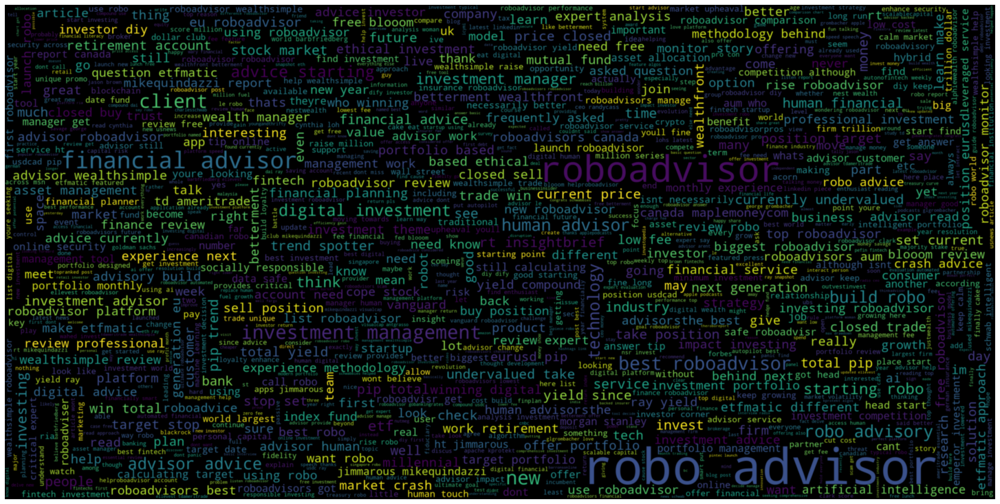

In [94]:
DP2.wordcld(unigrams2) #input must be unigrams

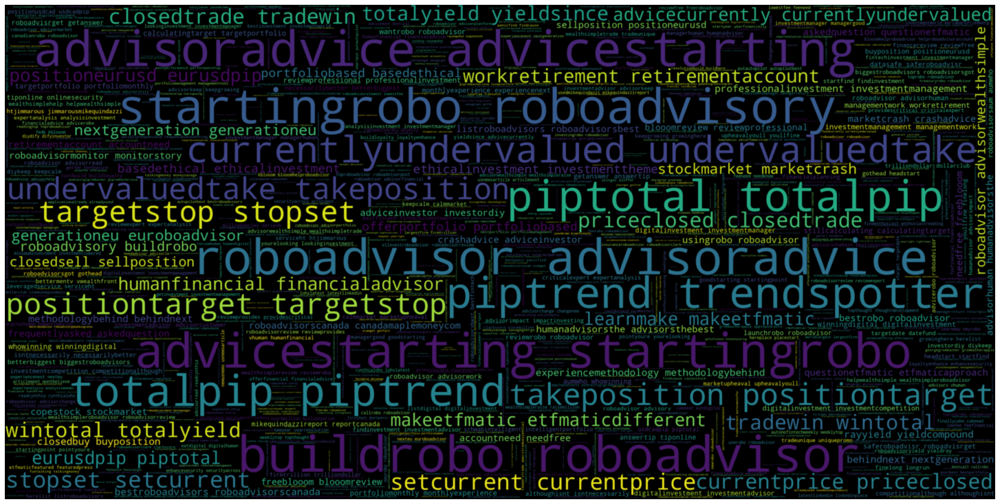

In [95]:
DP2.wordcld(bigrams2) #input must be unigrams

In [96]:
col=['tweet_id','tweet_url','text','text_html','links','hashtags', 'img_urls','timestamp','timestamp_epochs','likes','replies','retweets','username','screen_name','user_id','is_reply_to','is_replied','reply_to_users','parent_tweet_id','has_media']
DF2 = pd.DataFrame(columns=col)
for i in range(len(DP2.data)):
    tweets = pd.DataFrame(DP2.data[i])
    DF2 = DF2.append(tweets[col])
print("Number of tweets: ",len(DF2['text']))
DF2.head(5)

Number of tweets:  28131


,tweet_id,tweet_url,text,text_html,links,hashtags,img_urls,timestamp,timestamp_epochs,likes,replies,retweets,username,screen_name,user_id,is_reply_to,is_replied,reply_to_users,parent_tweet_id,has_media
0,876574079968522242,/axelrod_eric/status/876574079968522242,digrio How to Build a Robo Advisor Advice for ...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[http://www.businessinsider.com/robo-advisor-a...,[],[],2017-06-18T22:55:21,1497826521,0,0,1,Eric Axelrod,axelrod_eric,91705922,False,False,[],,False
1,876573742574559232,/ETFmatic/status/876573742574559232,Do you offer portfolios based on Ethical inve...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[http://bit.ly/2sIgf7s],"[FAQ, RoboAdvisor, CapitalAtRisk]",[],2017-06-18T22:54:00,1497826440,0,0,1,ETFs made simple 📱,ETFmatic,46628774,False,False,[],,False
2,876573240398757888,/digr_io/status/876573240398757888,How to Build a Robo Advisor Advice for Startin...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[http://www.businessinsider.com/robo-advisor-a...,[],[],2017-06-18T22:52:01,1497826321,0,0,1,DIGR,digr_io,4481835072,False,False,[],,False
3,876559916529528832,/mifid/status/876559916529528832,First regulated roboadviser raises m seed fund...,"<p class=""TweetTextSize js-tweet-text tweet-te...",[http://www.robo-advisor.market/p/4080012826/2...,"[investorseurope, Roboadvisor]",[],2017-06-18T21:59:04,1497823144,1,0,0,MiFID,mifid,46859075,False,False,[],,False
4,876549566710992897,/BColwell_Invest/status/876549566710992897,Tiny House Investing Issue with Man \n,"<p class=""TweetTextSize js-tweet-text tweet-te...",[https://www.linkedin.com/pulse/tiny-house-inv...,"[16, Investing, Machine, fintech, roboadvisor,...",[https://pbs.twimg.com/media/DCog7xnU0AASO6h.jpg],2017-06-18T21:17:56,1497820676,11,0,14,Brian D. Colwell,BColwell_Invest,718868889896026112,False,False,[],,True


In [97]:
DF2['timestamp'] = pd.to_datetime(DF2['timestamp'])
tweetsT = DF2['timestamp']

trace = go.Histogram(
    x=tweetsT,
    marker=dict(
        color='blue'
    ),
    opacity=0.75
)

layout = go.Layout(
    title='Tweet Activity Over Years',
    height=450,
    width=1200,
    xaxis=dict(
        title='Month and year'
    ),
    yaxis=dict(
        title='Tweet Quantity'
    ),
    bargap=0.2,
)

data = [trace]

fig = go.Figure(data=data, layout=layout)
py.offline.iplot(fig)

Text(0.5, 1.0, 'popular username')

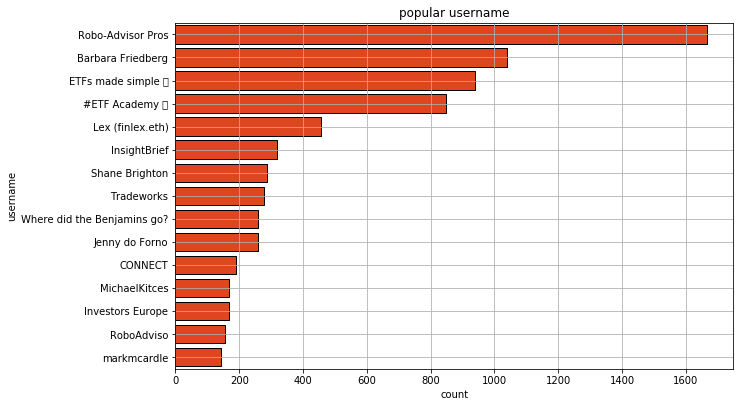

In [98]:
plt.figure(figsize = (10,14))

plt.subplot(211)
authors = DF2["username"].value_counts().reset_index()
sns.barplot(y = authors["index"][:15] , 
            x = authors["username"][:15] ,
            linewidth = 1,edgecolor = "k",color = "#FF3300")
plt.grid(True)
plt.xlabel("count")
plt.ylabel("username")
plt.title("popular username")

## Grading by positive/negative_words list

In [99]:
tweets2 = scoring_tweets(DF2,"text")


tweets2[["text","positive","negative","positive_count",
              "negative_count","score","sentiment"]].head()

,text,positive,negative,positive_count,negative_count,score,sentiment
0,digrio How to Build a Robo Advisor Advice for ...,,,0,0,0,neutral
1,Do you offer portfolios based on Ethical inve...,,,0,0,0,neutral
2,How to Build a Robo Advisor Advice for Startin...,,,0,0,0,neutral
3,First regulated roboadviser raises m seed fund...,,,0,0,0,neutral
4,Tiny House Investing Issue with Man \n,,,0,0,0,neutral


In [100]:
score_dist = tweets2[tweets2["retweets"] == False]["score"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red"),name = "Donald Trump"
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)

## Grading by Sentiment_Prediction_Model-LSTM

### one month

In [101]:
text_list_processedrobo = preprocess(DP2.textdata()[0])
resultrobo = predict(text_list_processedrobo)

In [102]:
score_dist = resultrobo["label"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution of Robo Advisor_2017-06",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red")
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)
# 2017-06

### 3 years

In [103]:
text_list_processed2 = preprocess(DP2.textdata()[0])
for i in range(1,36):
    for m in preprocess(DP2.textdata()[i]):
        text_list_processed2.append(m)

In [104]:
len(text_list_processed2)

28131

In [105]:
resultRobo2 = predict(text_list_processed2)

In [106]:
score_dist = resultRobo2["label"].value_counts().to_frame()
score_dist.columns = ["count"]
score_dist = score_dist.reset_index().sort_values(by = "index" ,ascending = False)

layout = go.Layout(dict(title = "Scores distribution of Robo Advisor_3 years",
                        plot_bgcolor  = "rgb(243,243,243)",
                        paper_bgcolor = "rgb(243,243,243)",
                        xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                     gridwidth = 2),
                        )
                  )

trace = go.Bar(x = score_dist["index"],
               y = score_dist["count"],
               marker = dict(line = dict(width = 1,color = "black"),
                             color = "red")
              )


fig = go.Figure(data = [trace],layout = layout)
py.offline.iplot(fig)